In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tslearn.clustering import KShape, TimeSeriesKMeans
from tslearn.preprocessing import TimeSeriesScalerMeanVariance
from tslearn.utils import to_time_series_dataset
from sklearn.model_selection import train_test_split, KFold, ParameterGrid
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report
from scipy.signal import butter, filtfilt
from scipy.stats import mode

# Cargar datos
data = np.loadtxt("/mnt/DGX0Raid/databases/bonn_dataset_columns_correct.csv", delimiter=",")[:, :].T
dataDF = pd.DataFrame(data)
X = to_time_series_dataset(data[:, 1:])
y = data[:, 0]

In [ ]:
dataDF.head(20)

,0,1,2,3,4,5,6,7,8,9,...,4088,4089,4090,4091,4092,4093,4094,4095,4096,4097
0,0.0,-76.0,-10.0,31.0,44.0,7.0,-55.0,-51.0,-40.0,-11.0,...,195.0,184.0,164.0,145.0,167.0,185.0,245.0,209.0,150.0,-51.0
1,0.0,34.0,31.0,29.0,19.0,16.0,12.0,3.0,-1.0,-5.0,...,-29.0,-22.0,-18.0,-14.0,-10.0,-9.0,0.0,5.0,3.0,-29.0
2,0.0,-57.0,-70.0,-78.0,-67.0,-57.0,-57.0,-57.0,-54.0,-43.0,...,-74.0,-69.0,-59.0,-45.0,-26.0,-29.0,-36.0,-48.0,-57.0,11.0
3,0.0,-4.0,-6.0,-6.0,-1.0,-11.0,-22.0,-13.0,-13.0,-6.0,...,-28.0,-23.0,-3.0,7.0,21.0,11.0,11.0,10.0,6.0,100.0
4,0.0,-41.0,-35.0,-28.0,-23.0,-20.0,-22.0,-28.0,-33.0,-30.0,...,25.0,16.0,10.0,11.0,10.0,8.0,8.0,2.0,-7.0,28.0
5,0.0,9.0,-2.0,-9.0,-17.0,-18.0,-16.0,-16.0,-33.0,-50.0,...,42.0,47.0,58.0,65.0,74.0,70.0,72.0,67.0,65.0,-31.0
6,0.0,-31.0,-36.0,-35.0,-33.0,-35.0,-30.0,-30.0,-23.0,-15.0,...,11.0,9.0,15.0,18.0,22.0,21.0,16.0,14.0,9.0,43.0
7,0.0,-148.0,-155.0,-156.0,-156.0,-150.0,-147.0,-141.0,-135.0,-131.0,...,-75.0,-95.0,-106.0,-103.0,-93.0,-81.0,-80.0,-81.0,-77.0,95.0
8,0.0,-27.0,-26.0,-19.0,-13.0,-8.0,-1.0,5.0,6.0,6.0,...,-58.0,-65.0,-67.0,-78.0,-77.0,-79.0,-82.0,-78.0,-72.0,-10.0
9,0.0,36.0,42.0,50.0,55.0,56.0,58.0,60.0,61.0,55.0,...,16.0,6.0,4.0,-1.0,0.0,0.0,-2.0,-1.0,5.0,-4.0


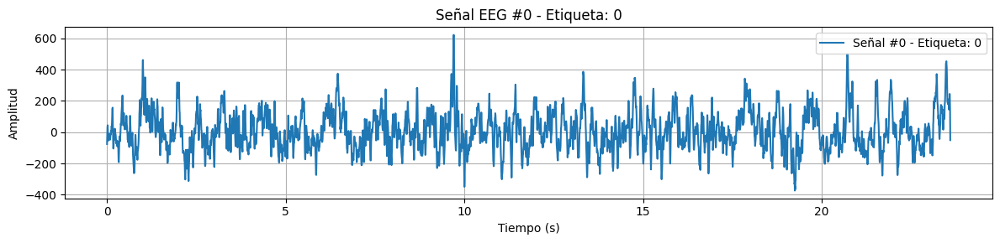

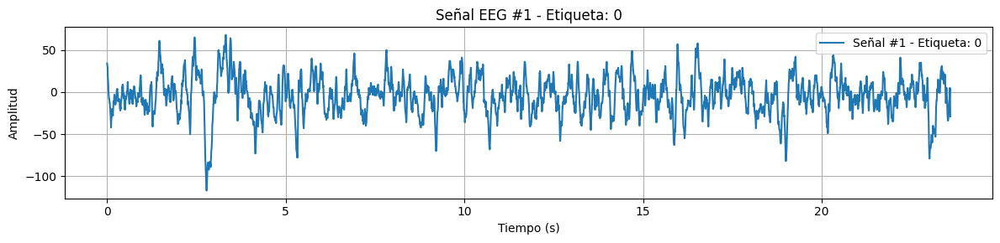

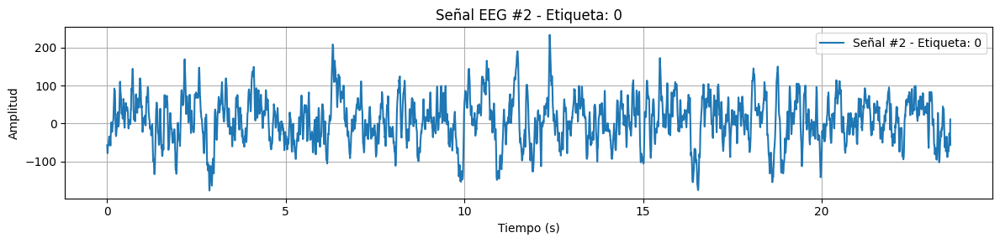

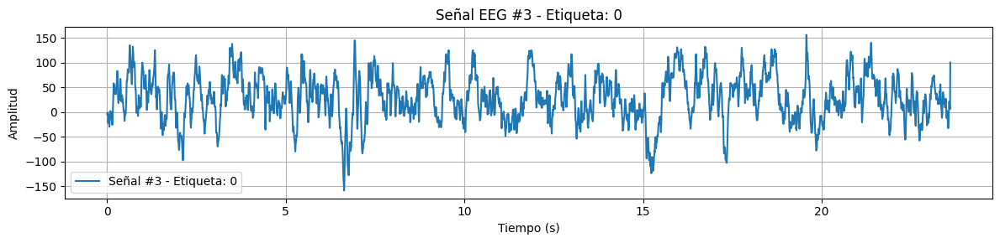

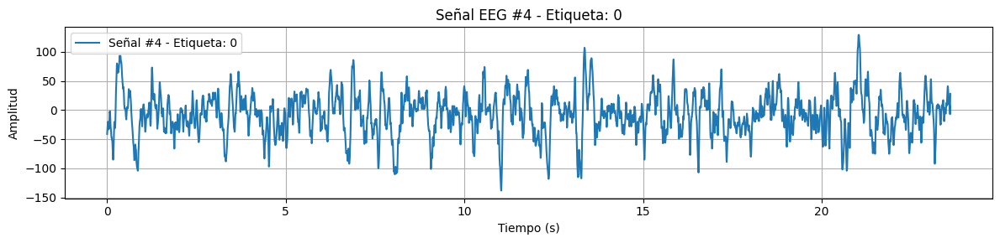

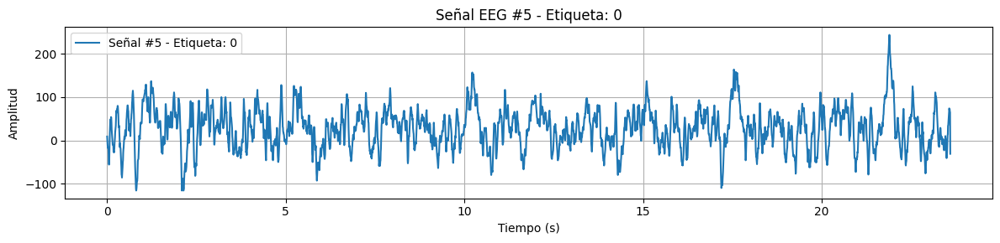

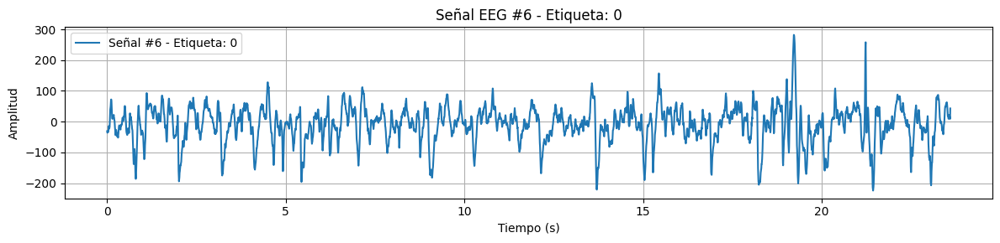

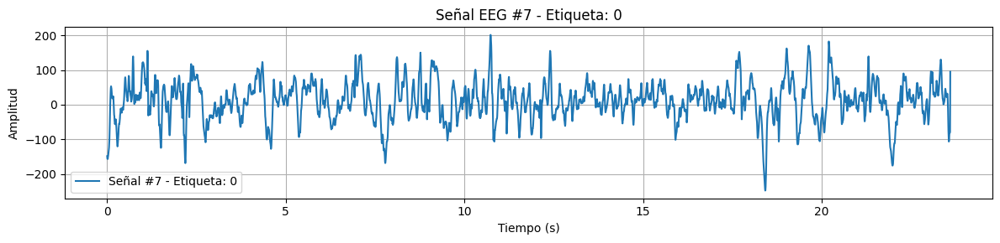

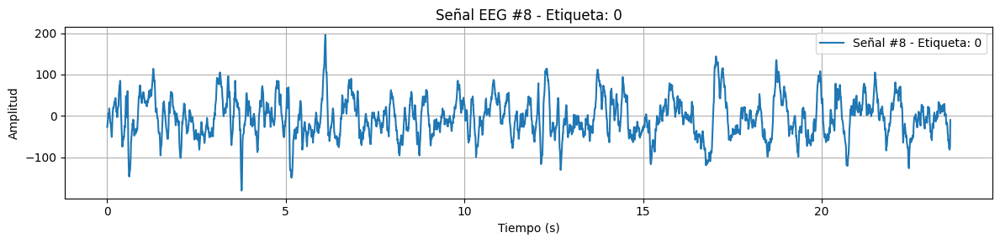

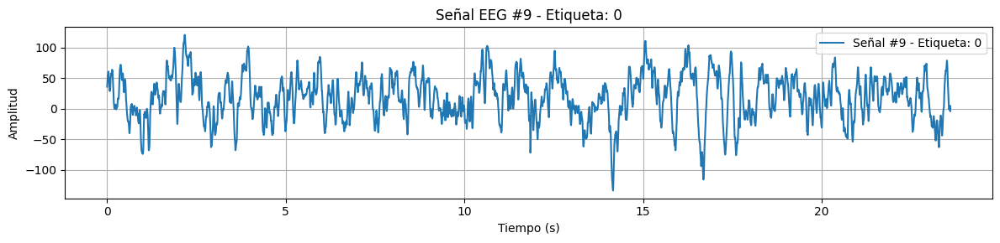

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Parámetros
fs = 173.61  # Frecuencia de muestreo
n_signals = X.shape[0]  # Número de señales
duration = X.shape[1] / fs  # Duración en segundos
t = np.linspace(0, duration, X.shape[1])  # Vector de tiempo

# Número máximo de señales a graficar (puedes cambiar esto)
max_signals_to_plot = 10  # Cambia a n_signals para graficar todo (no recomendado si son muchas)

# Graficar
for i in range(min(n_signals, max_signals_to_plot)):
    plt.figure(figsize=(12, 3))
    plt.plot(t, X[i], label=f'Señal #{i} - Etiqueta: {int(y[i])}')
    plt.title(f'Señal EEG #{i} - Etiqueta: {int(y[i])}')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.grid()
    plt.tight_layout()
    plt.legend()
    plt.show()


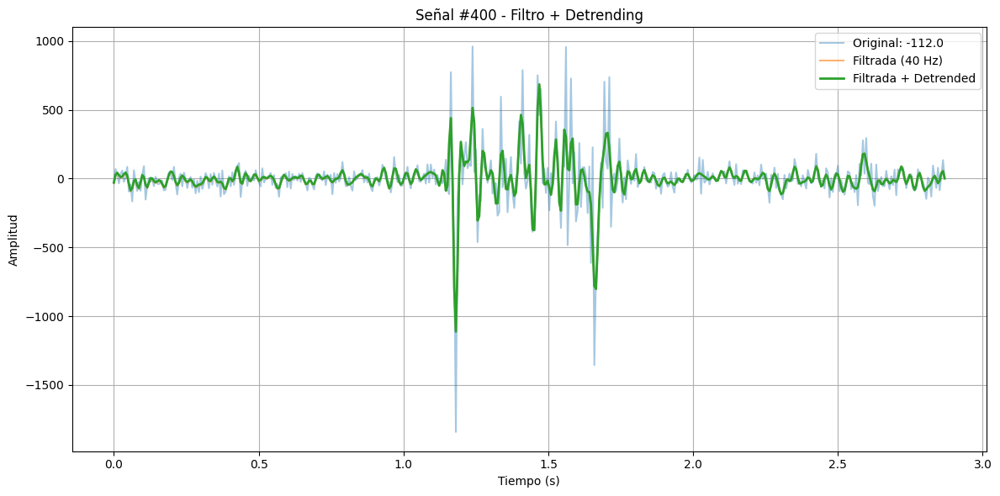

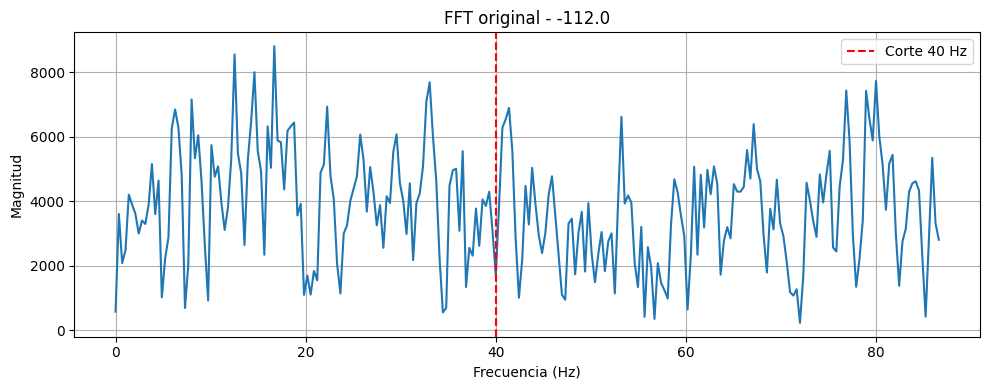

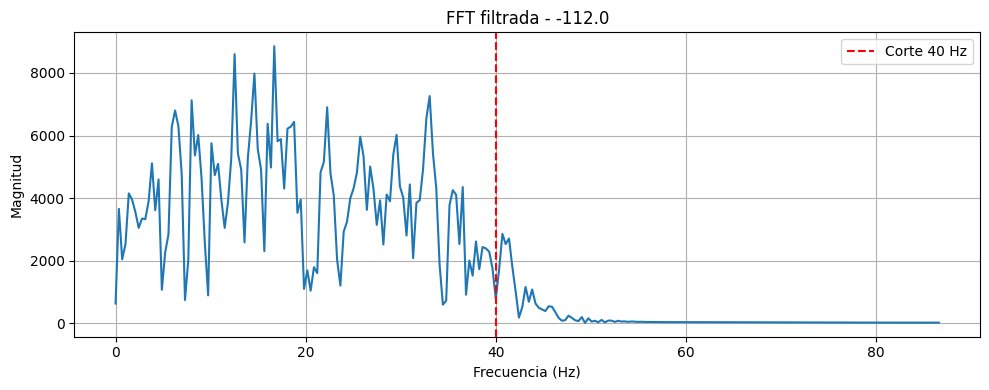

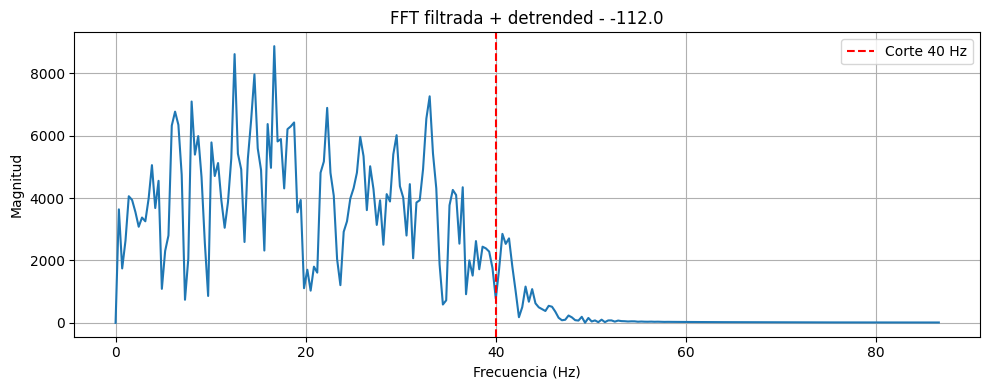

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, detrend

# 1. Parámetros
fs = 173.61  # Frecuencia de muestreo
cutoff = 40  # Filtro pasabajos a 40 Hz
orden_filtro = 5
archivo = '/mnt/DGX0Raid/databases/bonn_dataset_columns_correct.csv'  # Cambia esto si es necesario

# 2. Leer archivo CSV
df = pd.read_csv(archivo)

# 3. Separar etiquetas y datos de señales
labels = df.iloc[:, 0].values  # Primera columna: etiquetas
data = df.iloc[:, 1:].values   # Resto: señales (cada fila = una señal)

# 4. Función de filtro pasabajos
def lowpass_filter(data, cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return filtfilt(b, a, data)

# 5. Aplicar filtro a cada señal
filtered_data = np.array([lowpass_filter(row, cutoff, fs, orden_filtro) for row in data])

# 6. Aplicar detrending a las señales filtradas
detrended_data = np.array([detrend(row) for row in filtered_data])

# 7. Visualizar un ejemplo
t = np.arange(data.shape[1]) / fs
idx = 400  # Cambia el índice para ver otra señal

plt.figure(figsize=(12, 6))
plt.plot(t, data[idx], label=f'Original: {labels[idx]}', alpha=0.4)
plt.plot(t, filtered_data[idx], label='Filtrada (40 Hz)', alpha=0.6)
plt.plot(t, detrended_data[idx], label='Filtrada + Detrended', linewidth=2)
plt.xlabel('Tiempo (s)')
plt.ylabel('Amplitud')
plt.title(f'Señal #{idx} - Filtro + Detrending')
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

# 8. (Opcional) FFT para comparación
def plot_fft(signal, fs, title=''):
    freqs = np.fft.rfftfreq(len(signal), 1/fs)
    fft_vals = np.abs(np.fft.rfft(signal))

    plt.figure(figsize=(10, 4))
    plt.plot(freqs, fft_vals)
    plt.axvline(40, color='red', linestyle='--', label='Corte 40 Hz')
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('Magnitud')
    plt.title(title)
    plt.grid()
    plt.legend()
    plt.tight_layout()
    plt.show()

plot_fft(data[idx], fs, f'FFT original - {labels[idx]}')
plot_fft(filtered_data[idx], fs, f'FFT filtrada - {labels[idx]}')
plot_fft(detrended_data[idx], fs, f'FFT filtrada + detrended - {labels[idx]}')


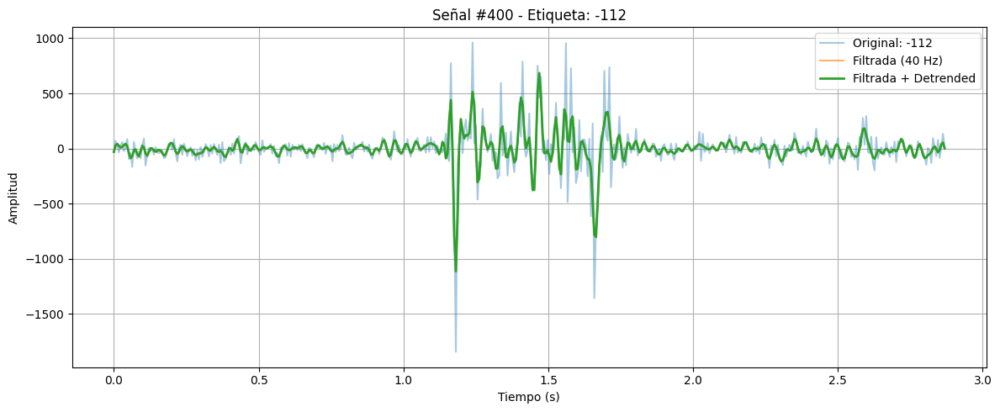

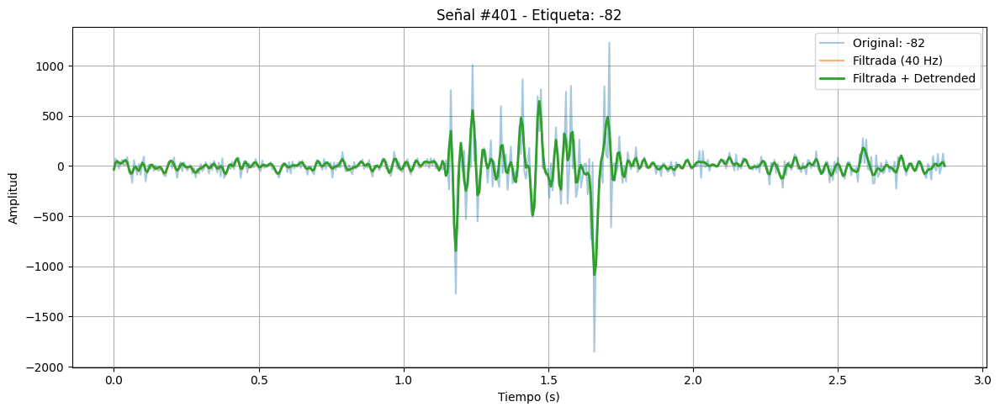

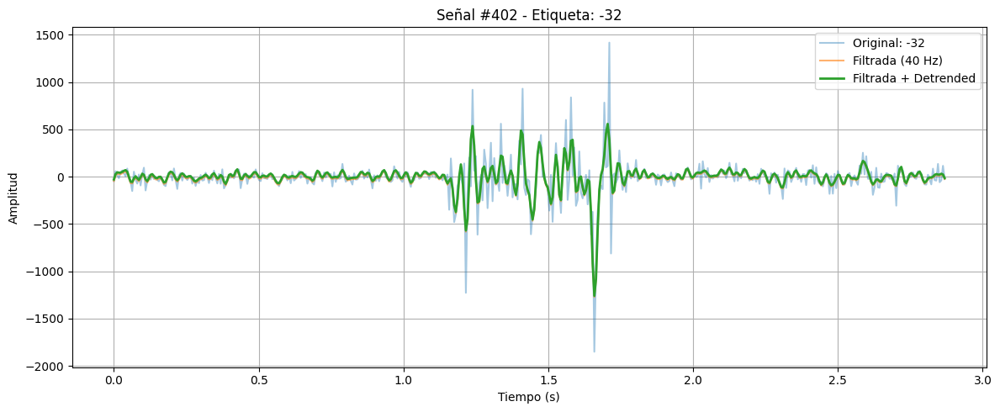

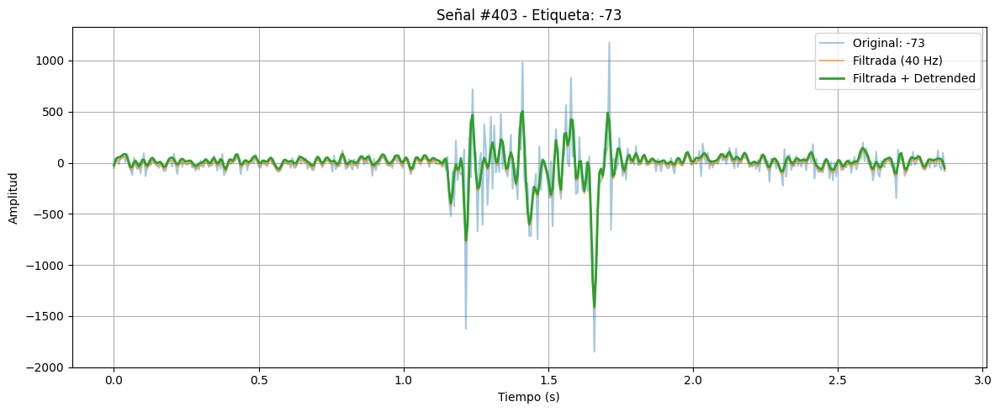

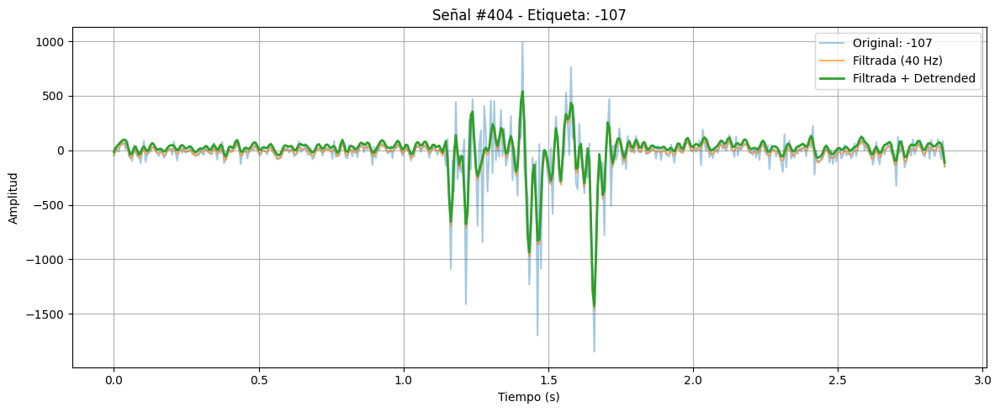

...

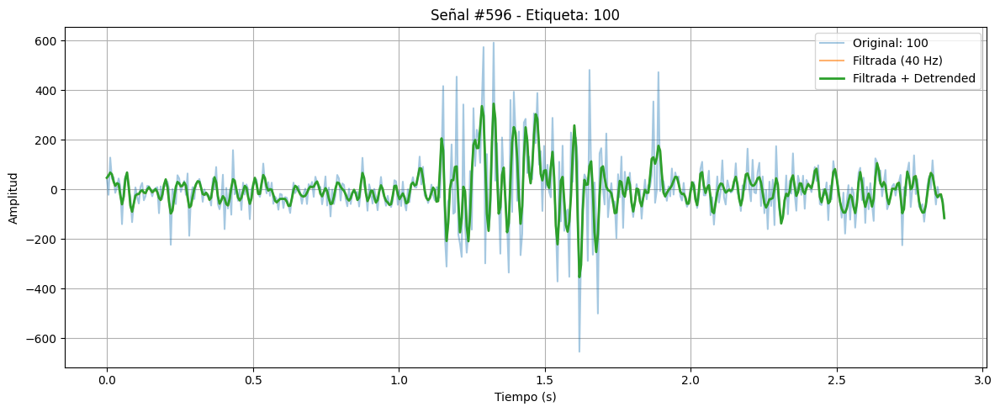

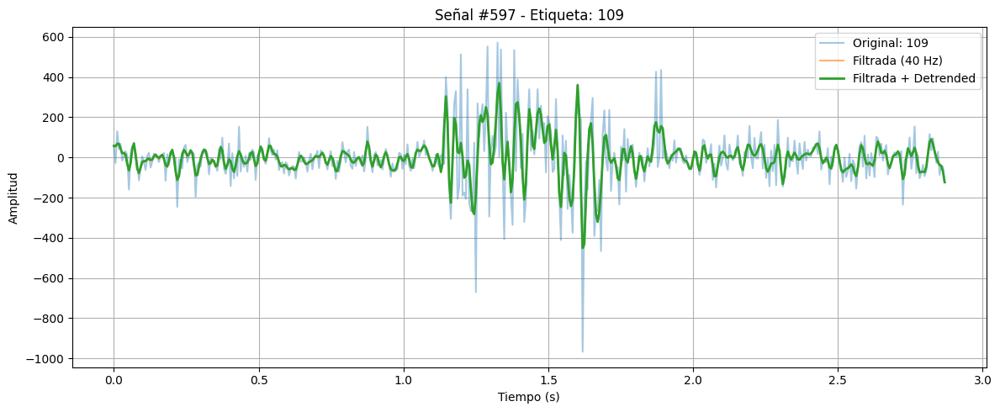

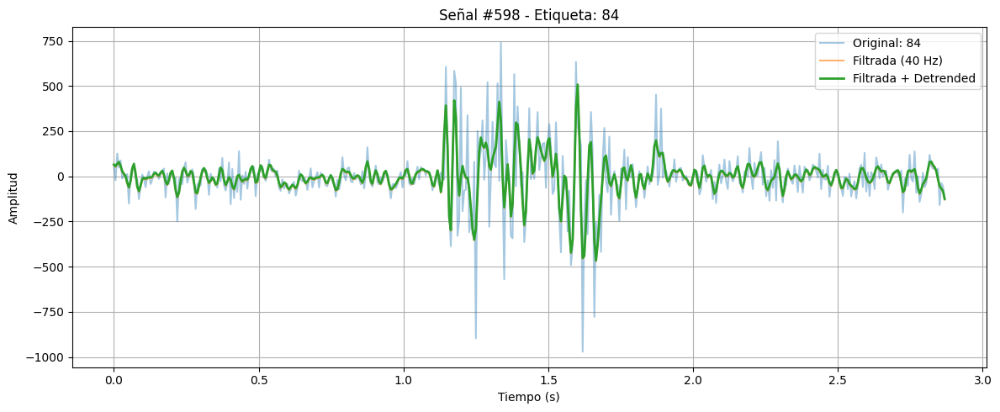

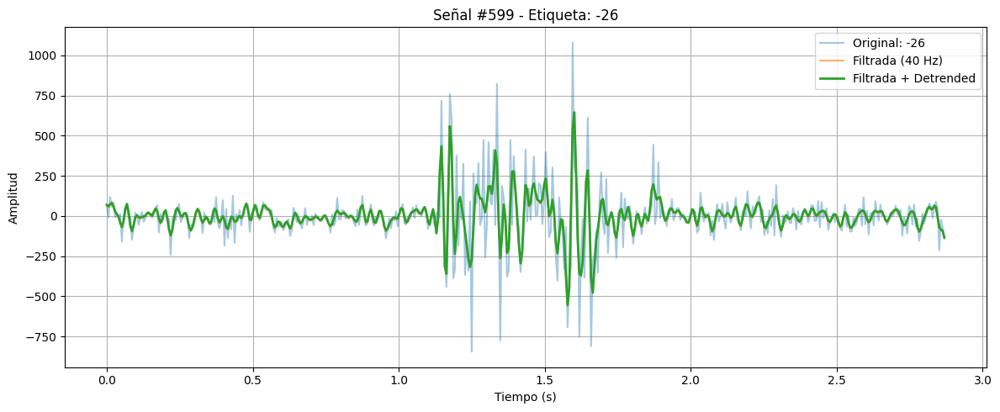

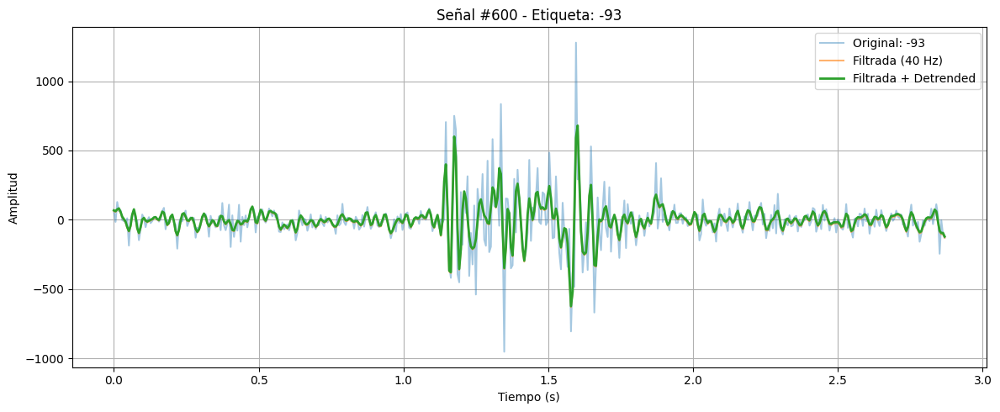

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, detrend

# 1. Parámetros
fs = 173.61  # Frecuencia de muestreo
cutoff = 40  # Filtro pasabajos a 40 Hz
orden_filtro = 5
archivo = '/mnt/DGX0Raid/databases/bonn_dataset_columns_correct.csv'

# 2. Leer archivo CSV
df = pd.read_csv(archivo)

# 3. Separar etiquetas y datos de señales
labels = df.iloc[:, 0].values  # Primera columna: etiquetas
data = df.iloc[:, 1:].values   # Resto: señales (cada fila = una señal)

# 4. Función de filtro pasabajos
def lowpass_filter(data, cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return filtfilt(b, a, data)

# 5. Aplicar filtro a cada señal
filtered_data = np.array([lowpass_filter(row, cutoff, fs, orden_filtro) for row in data])

# 6. Aplicar detrending a las señales filtradas
detrended_data = np.array([detrend(row) for row in filtered_data])

# 7. Graficar todas las señales en sus tres versiones
t = np.arange(data.shape[1]) / fs

for idx in range(400, 601):
    plt.figure(figsize=(12, 5))
    plt.plot(t, data[idx], label=f'Original: {int(labels[idx])}', alpha=0.4)
    plt.plot(t, filtered_data[idx], label='Filtrada (40 Hz)', alpha=0.6)
    plt.plot(t, detrended_data[idx], label='Filtrada + Detrended', linewidth=2)
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.title(f'Señal #{idx} - Etiqueta: {int(labels[idx])}')
    plt.legend()
    plt.grid()
    plt.tight_layout()
    plt.show()


Validación cruzada...

→ Evaluando configuración: {'n_clusters': 2, 'n_init': 3, 'tol': 0.001}
  Promedios:
    Accuracy   : 0.8725
    Precision  : 0.7392
    Recall     : 0.7708
    F1 Score   : 0.7499
    ARI        : 0.4572
    Silhouette : 0.0031
    
→ Evaluando configuración: {'n_clusters': 2, 'n_init': 3, 'tol': 1e-05}
  Promedios:
    Accuracy   : 0.8825
    Precision  : 0.7375
    Recall     : 0.7294
    F1 Score   : 0.7238
    ARI        : 0.4936
    Silhouette : 0.0026
    
→ Evaluando configuración: {'n_clusters': 2, 'n_init': 3, 'tol': 1e-06}
  Promedios:
    Accuracy   : 0.8825
    Precision  : 0.7375
    Recall     : 0.7294
    F1 Score   : 0.7238
    ARI        : 0.4936
    Silhouette : 0.0026
    
→ Evaluando configuración: {'n_clusters': 2, 'n_init': 3, 'tol': 1e-07}
  Promedios:
    Accuracy   : 0.8825
    Precision  : 0.7375
    Recall     : 0.7294
    F1 Score   : 0.7238
    ARI        : 0.4936
    Silhouette : 0.0026
    
→ Evaluando configuración: {'n_clusters':

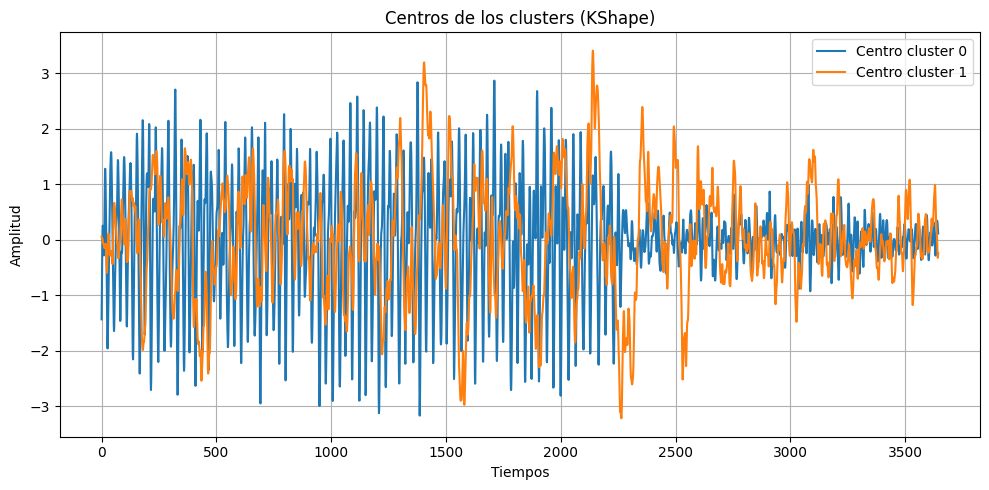

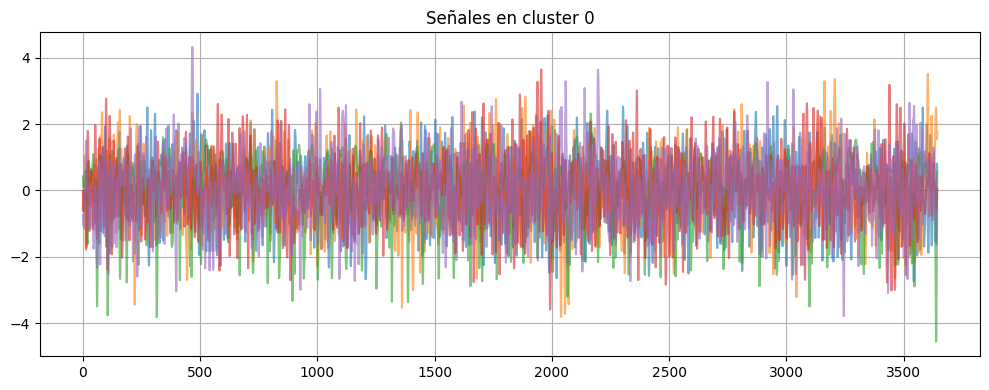

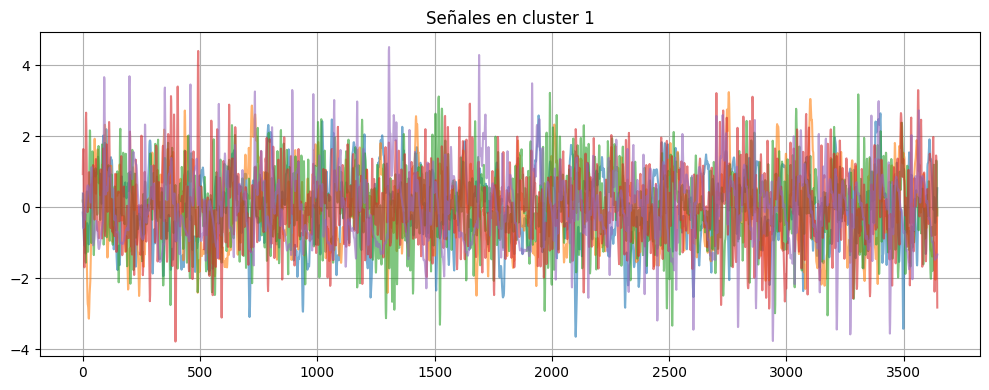

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tslearn.clustering import KShape
from tslearn.preprocessing import TimeSeriesScalerMeanVariance
from tslearn.utils import to_time_series_dataset
from sklearn.model_selection import train_test_split, KFold, ParameterGrid
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    confusion_matrix, adjusted_rand_score, silhouette_score
)
from scipy.signal import butter, filtfilt
from scipy.stats import mode
from joblib import Parallel, delayed

# ===================== CARGA Y PREPROCESAMIENTO =====================
# Cargar datos
data = np.loadtxt("/mnt/DGX0Raid/databases/bonn_dataset_columns_correct.csv", delimiter=",").T
X_raw = data[:, 1:]
y = data[:, 0].astype(int)

# Convertir a dataset de series temporales
X = to_time_series_dataset(X_raw)

# Dividir en train y test con stratify
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

# Extraer primeros 21 segundos
def extract_21_seconds_generator(X, fs=173.61, window_duration=21):
    num_samples = int(window_duration * fs)
    for signal in X:
        yield signal[:num_samples]

X_train_extracted = np.array(list(extract_21_seconds_generator(X_train))).squeeze(-1)
X_test_extracted = np.array(list(extract_21_seconds_generator(X_test))).squeeze(-1)

# Filtro pasa bajos
def low_pass_filter(signal, cutoff=40.0, fs=173.61, order=5):
    nyquist = 0.5 * fs
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return filtfilt(b, a, signal)

X_train_filtered = np.array([low_pass_filter(sig) for sig in X_train_extracted])
X_test_filtered = np.array([low_pass_filter(sig) for sig in X_test_extracted])

# Escalado
scaler = TimeSeriesScalerMeanVariance(mu=0., std=1.)
X_train_scaled = scaler.fit_transform(X_train_filtered)
X_test_scaled = scaler.transform(X_test_filtered)

# ===================== FUNCIÓN DE MAPEADO =====================
def map_clusters_to_labels(clusters, true_labels):
    true_labels = np.array(true_labels, dtype=int)
    label_map = {}
    for cluster in np.unique(clusters):
        mask = (clusters == cluster)
        true_mode = mode(true_labels[mask], keepdims=True).mode[0]
        label_map[cluster] = true_mode
    return np.array([label_map[c] for c in clusters]), label_map

# ===================== VALIDACIÓN CRUZADA PARALELA =====================
kf = KFold(n_splits=10, shuffle=True, random_state=42)
param_grid = {'n_clusters': [2], 'n_init': [3, 5, 6, 7, 10], 'tol': [1e-3, 1e-5, 1e-6, 1e-7, 1e-8]}

def run_kshape_fold(fold, train_idx, val_idx, params):
    X_tr, X_val = X_train_scaled[train_idx], X_train_scaled[val_idx]
    y_tr, y_val = y_train[train_idx], y_train[val_idx]

    model = KShape(**params, random_state=0)
    model.fit(X_tr)

    y_val_pred = model.predict(X_val)
    mapped_val, _ = map_clusters_to_labels(y_val_pred, y_val)

    X_val_flat = X_val.squeeze()
    sil_score = silhouette_score(X_val_flat, y_val_pred)

    return {
        'config': str(params),
        'fold': fold,
        'accuracy': accuracy_score(y_val, mapped_val),
        'precision': precision_score(y_val, mapped_val, average='macro'),
        'recall': recall_score(y_val, mapped_val, average='macro'),
        'f1': f1_score(y_val, mapped_val, average='macro'),
        'ari': adjusted_rand_score(y_val, y_val_pred),
        'silhouette': sil_score
    }

fold_results = []
summary_results = []

print("Validación cruzada...\n")
for params in ParameterGrid(param_grid):
    print(f"→ Evaluando configuración: {params}")

    results = Parallel(n_jobs=40)(
        delayed(run_kshape_fold)(fold+1, train_idx, val_idx, params)
        for fold, (train_idx, val_idx) in enumerate(kf.split(X_train_scaled))
    )

    fold_results.extend(results)

    avg_metrics = {
        'config': str(params),
        'accuracy': np.mean([r['accuracy'] for r in results]),
        'precision': np.mean([r['precision'] for r in results]),
        'recall': np.mean([r['recall'] for r in results]),
        'f1': np.mean([r['f1'] for r in results]),
        'ari': np.mean([r['ari'] for r in results]),
        'silhouette': np.mean([r['silhouette'] for r in results])
    }

    summary_results.append(avg_metrics)

    print(f"""  Promedios:
    Accuracy   : {avg_metrics['accuracy']:.4f}
    Precision  : {avg_metrics['precision']:.4f}
    Recall     : {avg_metrics['recall']:.4f}
    F1 Score   : {avg_metrics['f1']:.4f}
    ARI        : {avg_metrics['ari']:.4f}
    Silhouette : {avg_metrics['silhouette']:.4f}
    """)

summary_df = pd.DataFrame(summary_results)
all_folds_df = pd.DataFrame(fold_results)

print("\n==== Resumen final por configuración ====")
print(summary_df.sort_values(by="f1", ascending=False).round(4))

# ===================== MODELO FINAL (mejor configuración) =====================
# Convertir string a dict
best_params = eval(summary_df.sort_values(by="f1", ascending=False).iloc[0]['config'])
print(f"\n→ Entrenando modelo final con mejor configuración: {best_params}")

model = KShape(**best_params, random_state=0)
model.fit(X_train_scaled)

# ===================== EVALUACIÓN FINAL =====================
def evaluate_and_print(X_set, y_true, model, set_name=""):
    y_pred = model.predict(X_set)
    mapped_pred, _ = map_clusters_to_labels(y_pred, y_true)

    acc = accuracy_score(y_true, mapped_pred)
    prec = precision_score(y_true, mapped_pred, average='macro')
    rec = recall_score(y_true, mapped_pred, average='macro')
    f1 = f1_score(y_true, mapped_pred, average='macro')
    ari = adjusted_rand_score(y_true, y_pred)

    print(f"\n====== Evaluación en {set_name} ======")
    print(f"Accuracy:  {acc:.4f}")
    print(f"Precision: {prec:.4f}")
    print(f"Recall:    {rec:.4f}")
    print(f"F1 Score:  {f1:.4f}")
    print(f"ARI:       {ari:.4f}")
    print("\nMatriz de confusión:")
    print(confusion_matrix(y_true, mapped_pred))

    return acc, prec, rec, f1, ari, mapped_pred

train_metrics = evaluate_and_print(X_train_scaled, y_train, model, "train")
test_metrics = evaluate_and_print(X_test_scaled, y_test, model, "test")

# ===================== VISUALIZACIÓN =====================
plt.figure(figsize=(10, 5))
for i, center in enumerate(model.cluster_centers_):
    plt.plot(center.ravel(), label=f'Centro cluster {i}')
plt.title("Centros de los clusters (KShape)")
plt.xlabel("Tiempos")
plt.ylabel("Amplitud")
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()

assignments = model.predict(X_train_scaled)
for cluster_id in np.unique(assignments):
    signals = X_train_scaled[assignments == cluster_id]
    plt.figure(figsize=(10, 4))
    for i in range(min(5, len(signals))):
        plt.plot(signals[i].ravel(), alpha=0.6, label=f'Señal {i+1}')
    plt.title(f"Señales en cluster {cluster_id}")
    plt.grid()
    plt.tight_layout()
    plt.show()


In [ ]:
from scipy.stats import ttest_1samp

# ===================== P-TEST F1 CONTRA OTRAS CONFIGS =====================
# Obtener la mejor configuración por f1
summary_sorted = summary_df.sort_values(by="f1", ascending=False).reset_index(drop=True)
best_config_str = summary_sorted.loc[0, "config"]
best_f1 = summary_sorted.loc[0, "f1"]

# Obtener F1 de las demás configuraciones
other_f1_scores = summary_sorted.loc[1:, "f1"].values

# Realizar test estadístico: ¿Es el mejor F1 significativamente mayor que los otros?
t_stat, p_value = ttest_1samp(other_f1_scores, popmean=best_f1)

print(f"\n===== TEST ESTADÍSTICO: ¿Mejor F1 es significativo? =====")
print(f"Mejor configuración: {best_config_str}")
print(f"F1-score de mejor modelo: {best_f1:.4f}")
print(f"F1 promedio resto configuraciones: {np.mean(other_f1_scores):.4f}")
print(f"t-statistic: {t_stat:.4f}")
print(f"p-value: {p_value:.4f}")

if p_value < 0.05:
    print("→ Resultado estadísticamente significativo (p < 0.05): la mejor configuración tiene un F1-score significativamente mayor.")
else:
    print("→ Resultado NO estadísticamente significativo (p ≥ 0.05): la mejor configuración no es significativamente mejor.")



===== TEST ESTADÍSTICO: ¿Mejor F1 es significativo? =====
Mejor configuración: {'n_clusters': 2, 'n_init': 10, 'tol': 1e-08}
F1-score de mejor modelo: 0.8146
F1 promedio resto configuraciones: 0.7603
t-statistic: -10.5801
p-value: 0.0000
→ Resultado estadísticamente significativo (p < 0.05): la mejor configuración tiene un F1-score significativamente mayor.
